In [2]:
# Import Relevant Modules

# For Vector Calculations
import numpy as np
import math as mh
import scipy as sp
import pandas as pd

# Import Visualisation Algorithms
import matplotlib.pyplot as plt
import seaborn as sns 
import plotly.graph_objects as go 

# For generating Randomness
import random

(1000,)
(1000,)


c:\Users\kdarn\anaconda3\envs\TenseNeuralNets\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\TenseNeuralNets\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


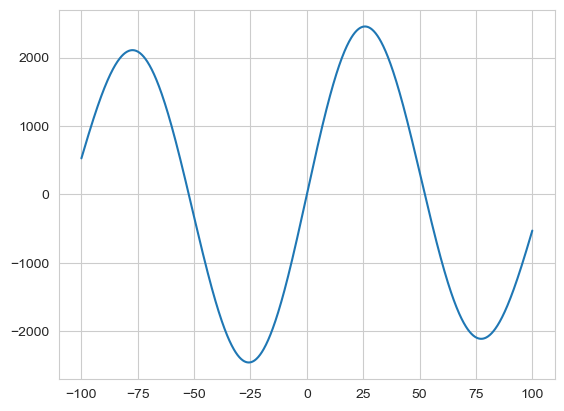

(1000,)


c:\Users\kdarn\anaconda3\envs\TenseNeuralNets\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\kdarn\anaconda3\envs\TenseNeuralNets\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


<Figure size 640x480 with 0 Axes>

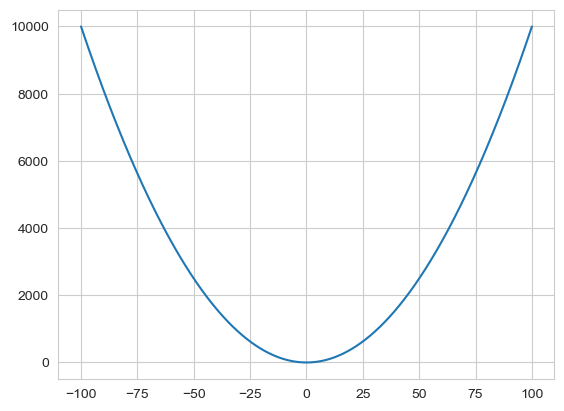

(1000,)


<Figure size 640x480 with 0 Axes>

In [3]:
# Define The Problem:

# Define the Gabor Model:
def Gabor_1d(x, a, b):
    y = 5e3*np.sin(a + 0.06*b*x)*np.cos(a + 0.06*b*x)*np.exp(-(a + 0.06*b*x)**2/(32.0))
    return y

def Gabor_2d(x,y,a,b):
    y_1 = Gabor_1d(x,a,b)
    y_2 = Gabor_1d(y,a,b)
    return y_1 + y_2

# Define the Convex Function:
def Quad_1d(x):
    return x**2 

def Quad_2d(x,y):
    return 1.0*Quad_1d(1.5*x) + 3.0*Quad_1d(y) 

# Define the Fitness Function to be optimisied:
def Fitness_Function(data,a,b,c, noise_encodings):
    x,y = data
    z = -(2.0*Quad_2d(x,y) + Gabor_2d(x,y,a,b) + c*Gabor_2d(x,y,a,b*5) + noise_encodings) + 1.25e5
    return z/1e3

# Define the Domain Space:
x = np.linspace(-100, 100, 1000)
y = np.linspace(-100, 100, 1000)
noise = 1e3*np.random.uniform(0.0, 100.0)
Domain_x, Domain_y = np.meshgrid(x,y)
a,b,c = 0,0.5,2.0
Fit = Fitness_Function([x,y],a,b,c, noise)
print(Fit.shape)
sns.set_style("whitegrid")

# Plot the slices of the Fitness function:
plt.figure()
print(Gabor_1d(x,a,b).shape)
sns.lineplot(x = x, y = Gabor_1d(x,a,b))
plt.show()
plt.clf()

plt.figure()
print(Quad_2d(x,y).shape)
sns.lineplot(x = x, y = Quad_1d(x))
plt.show()
plt.clf()

print(Fit.shape)


In [4]:
# Check the shapes are okay
Domain_x.shape

(1000, 1000)

In [5]:
# Check that the shapes are okay
Fitness_Function([Domain_x, Domain_y], a,b,c, noise).shape

(1000, 1000)

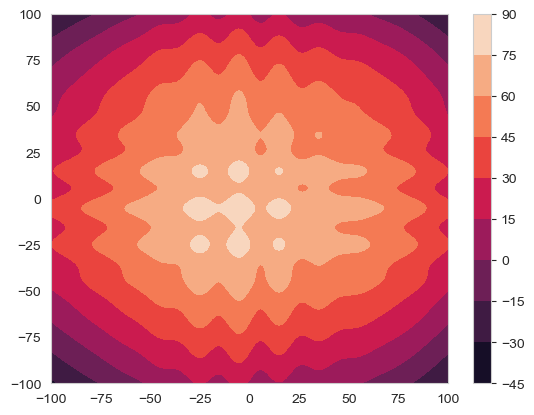

In [6]:
# Visualise the Fitness Function in 2D
plt.contourf(Domain_x, Domain_y, Fitness_Function([Domain_x, Domain_y], a,b,c, noise))
plt.colorbar()
plt.show()

In [7]:
# Optimal Value for the Fitness Function
np.max(Fitness_Function([Domain_x, Domain_y], a,b,c, noise))

84.6085283339382

In [8]:
# 3D surface plot showing fitness function being optimised. This function was chosen due to the presence of many local minima and single global minima. 
# It was made by combining a convex function with a non-convex function.
fig = go.Figure(data = 
                go.Surface(x = x, y = y, z = Fitness_Function([Domain_x, Domain_y], a,b,c, noise)))
fig.show()

In [9]:
# Define the Parameters of the Problem
Population_Size = 48
Max_Iterations = 300
Params = {"Population_Size": Population_Size, "Max_Iterations": Max_Iterations}

# Define the Search Space of Problem:
Search_Space = {"X_value":np.linspace(start = -100.0,stop = 100.0,num = 5000), "y_value":np.linspace(start = -100.0, stop = 100.0, num = 5000)}

In [10]:
# Checks to search Search Space is Functioning
random.choice(Search_Space["X_value"])

81.07621524304861

In [11]:
# Generates a function handler to simplify the code below
def Fit_Function(Data):
    return Fitness_Function(Data, a,b,c,noise)

0
Average_Score: 39.17150740592162


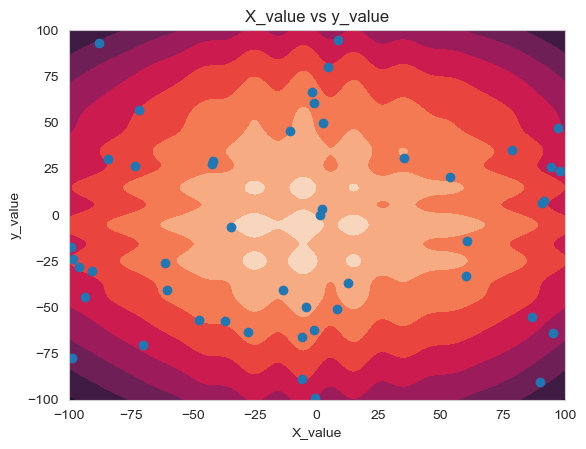

5
Average_Score: 74.07085062405156


<Figure size 640x480 with 0 Axes>

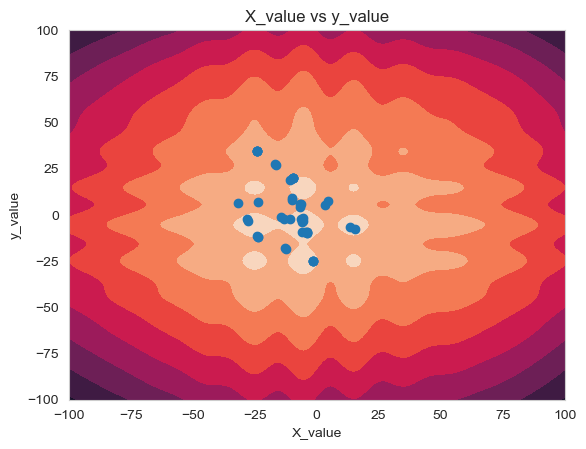

10
Average_Score: 84.0305877998577


<Figure size 640x480 with 0 Axes>

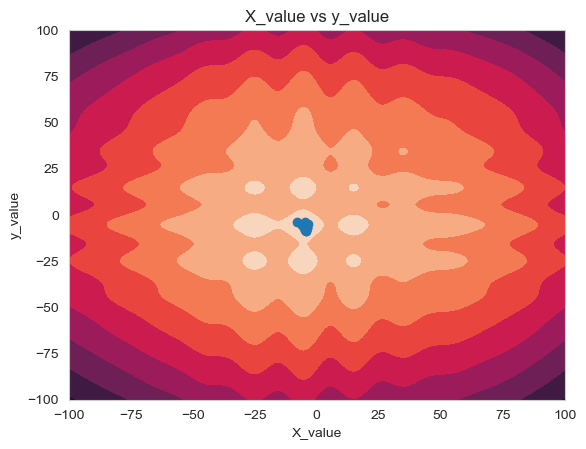

15
Average_Score: 84.51847138937549


<Figure size 640x480 with 0 Axes>

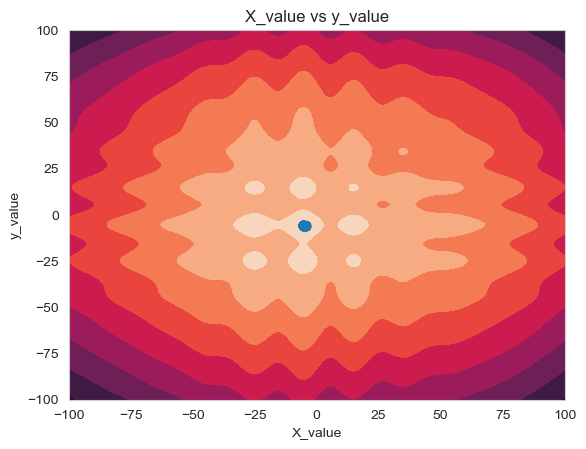

20
Average_Score: 84.52596899903085


<Figure size 640x480 with 0 Axes>

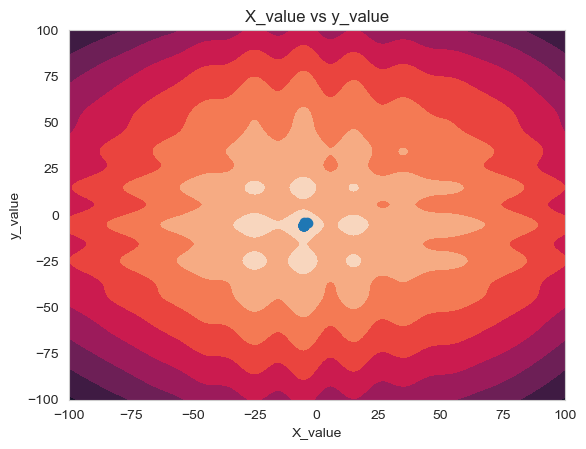

(84.58386947914796,
 [{'X_value': -5.356312090273652, 'y_value': -5.663343322854545},
  {'X_value': -5.356312090273652, 'y_value': -5.663343322854545},
  {'X_value': -5.350794347216798, 'y_value': -5.6682633441806125},
  {'X_value': -5.3507942429607045, 'y_value': -5.668263437142933},
  {'X_value': -5.350793491082039, 'y_value': -5.668264281974214}])

<Figure size 640x480 with 0 Axes>

In [12]:
class Real_GeneticAlgorithm_Solver:
    """
    Defines a Real-Valued Evolutionary Algorithm that finds the maximium of an objective
    function using Gaussian Mutuation, Weighted_Arithmetric_Crossover and Linear_Normalised Scaling
    for Natural Selection. Dictionaries are used to store individual members of the population.
    The Population is represented by a list.
    """

    # The constructor takes in the Population Size, 
    # Maximum number of iterations and fitness criterion
    def __init__(self, Population_Size, Max_Iterations, Fitness_Function, plot = False):
        self.Population_Size = Population_Size
        self.Max_Iterations = Max_Iterations
        self.Fitness_Function = Fitness_Function
        self.plot = plot

    # The following function randomly initialises the population being used.
    def Initialise_Population(self, Search_Space):
        self.Population = []
        Parameters = Search_Space.keys()
        index = 0
        while index <= Population_Size-1:
            Individual = {}
            for parameter in Parameters:
                Individual[parameter] = random.choice(Search_Space[parameter])
            index +=1
            self.Population.append(Individual)
    
    # Natural Selection is implement using a distribution of normalised fitness scores
    # To weight the probability of a certain member of the population being chosen.
    # Weighting is derived from normalised fitness scores to ensure that scaling is maintained throughout
    # Natural Selection culls the population to about half it's original size, to keep the top 50% of the population
    def Natural_Selection(self):
        K_remaining = round(1/2 * Population_Size)
        self.Selected_Population = []
        index = 0       
        Fitness_Distribution = []
        Fitness_Distribution = self.Compute_Population_Fitness()
        Fitness_Distribution = np.array(Fitness_Distribution)
        sorted_indices = sorted(range(len(Fitness_Distribution)), key = lambda k: Fitness_Distribution[k], reverse= True)
        range_min_max = Fitness_Distribution.max() - Fitness_Distribution.min()
        if range_min_max != 0:
            Normalised_Fitness_Distribution = (Fitness_Distribution - Fitness_Distribution.min())/(Fitness_Distribution.max() - Fitness_Distribution.min())
            Linear_Probabilities = (Normalised_Fitness_Distribution)/(np.sum(Normalised_Fitness_Distribution))
            Linear_Probabilities[np.isnan(Linear_Probabilities)] = 0
            Chosen_Indices = np.random.choice(sorted_indices, p = Linear_Probabilities[sorted_indices], replace = True, size = K_remaining)
        else:
            return True
        
        index = 0
        while index <= len(Chosen_Indices) - 1:
            Chosen_Index = Chosen_Indices[index]
            self.Selected_Population.append(self.Population[Chosen_Index])
            index+=1
    
    # Reproduction is done by iteratively picking pairs of candidate solutions to obtain two parents to produce offspring. 
    # Offspring are generated using the weighted arithmetric crossover method and then mutuation is applied to encourage diversity
    # in Offspring, before the offspring are added back into the gene pool to form the new full Population
    def Reproduction(self, Mutuation_Rate, std):
        def sample_pairings(s):
            indices = list(range(len(s)))
            random.Random().shuffle(indices)
            i,j = random.sample(indices,2)
            return s[i],s[j]
        
        Population = []
        Child_Population = []
        index = 0

        while index <= len(self.Selected_Population)//2 - 1:
            Parent_1, Parent_2 = sample_pairings(self.Selected_Population)
            Offspring_1, Offspring_2 = self.Weighted_Arithmetric_Crossover(Parent_1,Parent_2)
            Population.append(Parent_1)
            Population.append(Parent_2)
            Child_Population.append(Offspring_1)
            Child_Population.append(Offspring_2)
            index+=1

        Mutuated_Child_Population = self.Mutuation(Child_Population, Mutuation_Rate, std)
        Population.extend(Mutuated_Child_Population)
        self.Population = Population

    # Mutation works by first determining whether a mutation is to okay and then by applying a gaussian noise operator to 
    # knock the parameter off it's original value 
    def Mutuation(self, Population, Mutation_Rate, std):
        Population_Size = len(Population)
        index = 0
        while index <= Population_Size - 1:
            Individual = Population[index]
            Choice = random.choices(["Y", "N"], weights = [Mutation_Rate, 1-Mutation_Rate], k = 1)
            if "Y" in Choice:
                for parameter in Individual.keys():
                    Gaussian_Mutation = np.random.uniform(0,std, 1)
                    Individual[parameter] = list(Individual[parameter] + Gaussian_Mutation)[0]
            index +=1

        return Population

    # Weighted Arithmetric Crossover works by calculating the weighted mean of the Parent's Parameters. 
    # The Parameters of the Parents are weighted by their Fitness Scores.
    def Weighted_Arithmetric_Crossover(self,Candidate_1, Candidate_2):
        Parameters = list(Candidate_1.keys())
        Offspring_1, Offspring_2 = {}, {}
        Candidate_1_Fitness = self.Fitness_Function(Candidate_1.values())
        Candidate_2_Fitness = self.Fitness_Function(Candidate_2.values())
        index = 0
        while index <= len(Parameters) -1:
            Parameter = Parameters[index]
            Offspring_1[Parameter] = ((Candidate_1_Fitness*Candidate_1[Parameter] + Candidate_2_Fitness*Candidate_2[Parameter])/(Candidate_1_Fitness + Candidate_2_Fitness))
            Offspring_2[Parameter] = ((Candidate_2_Fitness*Candidate_1[Parameter] + Candidate_1_Fitness*Candidate_2[Parameter])/(Candidate_1_Fitness + Candidate_2_Fitness))
            index+=1
        return Offspring_1, Offspring_2
    
    # The function responsible for computing the Fitness scores for the population.
    def Compute_Population_Fitness(self):
        index = 0
        Fitness_Distribution = []
        while index <= len(self.Population) - 1:
            #print(list(self.Population[index].values()))
            Fitness_Distribution.append(self.Fitness_Function(list(self.Population[index].values())))
            index+=1
        return Fitness_Distribution
    
    # The function for reponsible for plotting the position of members in the population every few Generations:
    def Plotter(self):
        Params = list(self.Population[0].keys())
        Population_X_values = [Individual[Params[0]] for Individual in self.Population]
        Population_y_values = [Individual[Params[1]] for Individual in self.Population]
        Fig = plt.figure()
        Domain_x, Domain_y = np.meshgrid(Search_Space["X_value"], Search_Space["y_value"])
        plt.contourf(Domain_x, Domain_y, self.Fitness_Function([Domain_x, Domain_y]))
        plt.scatter(Population_X_values, Population_y_values)
        plt.xlabel(Params[0])
        plt.ylabel(Params[1])
        plt.title(f"{Params[0]} vs {Params[1]}")
        return Fig
        

    # Runs the algorithm, iteratively performing the steps of genetic algorithms until performance stops.
    # Uncomment the commented print statements for more information.
    def Run_Genetic_Algorithm(self, Search_Space, Mutuation_Rate, std, num_candidates):

        self.Initialise_Population(Search_Space)
        Iterations = 0
        Best_Score = -np.inf
        Fitness_median = -np.inf
        threshold = 0.00001
        Twice = False
        Fitness_Distribution = self.Compute_Population_Fitness()
        
        while ((np.median(Fitness_Distribution) - Fitness_median) >= threshold or not(Twice)) and Iterations < self.Max_Iterations:
            #print(np.median(Fitness_Distribution), Fitness_median)
            #print(Iterations)
            if not((np.median(Fitness_Distribution) - Fitness_median) >= threshold):
                Twice = True
            Best_Score = np.max(Fitness_Distribution)
            Fitness_median = np.quantile(Fitness_Distribution, 0.45)
            #print(f"Average_Score:",np.mean(Fitness_Distribution))
            if Iterations % 5 == 0 and self.plot == True:
                print(Iterations)
                print(f"Average_Score:",np.mean(Fitness_Distribution))
                Figure = self.Plotter()
                plt.show()
                plt.clf()
            Flag = self.Natural_Selection()
            if Flag:
                break
            self.Reproduction(Mutuation_Rate, std)
            Fitness_Distribution = self.Compute_Population_Fitness()
            Iterations +=1

        #print(Iterations)
        Best_Score = np.max(Fitness_Distribution)
        Fitness_Distribution = self.Compute_Population_Fitness()
        #print(f"Final_Average_Score:",np.mean(Fitness_Distribution))
        #print(f"Final_Best_Score", Best_Score)
        sorted_indices = sorted(range(len(Fitness_Distribution)), key = lambda k: Fitness_Distribution[k], reverse= True)
        Sorted_Population = [self.Population[index] for index in sorted_indices]
        Best_Candidates = Sorted_Population[:num_candidates]
        return Best_Score, Best_Candidates

# Creates an object of the class and runs the solver.
GA_Run = Real_GeneticAlgorithm_Solver(Params["Population_Size"], Params["Max_Iterations"], Fit_Function, plot = True)
GA_Run.Run_Genetic_Algorithm(Search_Space, 0.10, 2.0, 5)

80.88149144854881 3.397040382634407 79.38240970906806 81.07155976341855 83.96714451660007


(71.53781049237911, 84.60829921087883)

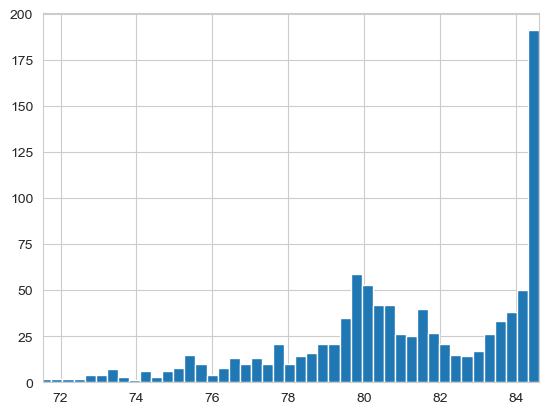

In [13]:
# Prints the distribution of Optimal Scores Obtained by the Algorithm
Scores = []
GA_Run = Real_GeneticAlgorithm_Solver(Params["Population_Size"], Params["Max_Iterations"], Fit_Function, plot = False)
for index in range(1000):
    Best_Score, _ = GA_Run.Run_Genetic_Algorithm(Search_Space, 0.05, 1.0, 2)
    Scores.append(Best_Score)
print(np.mean(Scores), np.std(Scores), np.quantile(Scores, 0.25), np.median(Scores), np.quantile(Scores, 0.75))
plt.hist(Scores, bins = 100)
plt.xlim([np.quantile(Scores,0.01),np.quantile(Scores,0.99)])

Iterations 0
Best_Score: 81.96071632674813


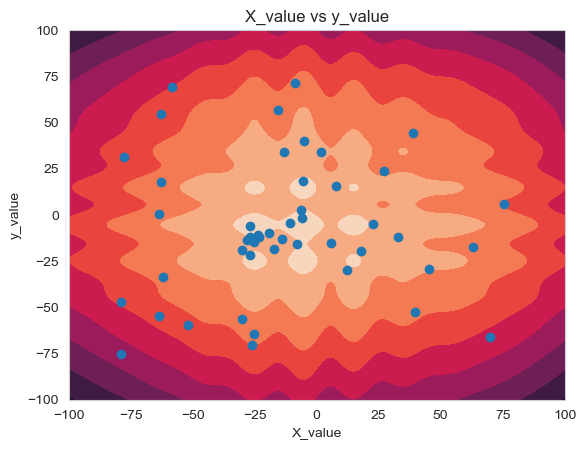

Iterations 5
Best_Score: 84.26466418953338


<Figure size 640x480 with 0 Axes>

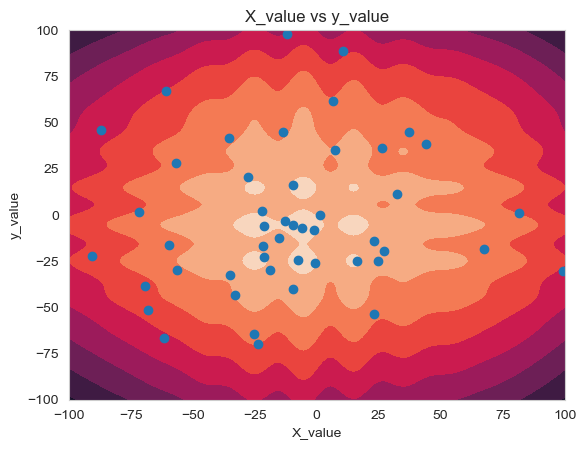

(84.26466418953338,
 {'X_value': -5.226119203871427, 'y_value': -4.11582485379714})

<Figure size 640x480 with 0 Axes>

In [14]:
class ParticleSwarm:
    # The constructor creates the ParticleSwarm object and initialises the key parameters
    def __init__(self, Population_Size, Max_Iterations, Fitness_Function, Search_Space, Velocity_Range, plot):
        self.Population_Size = Population_Size
        self.Max_Iterations = Max_Iterations
        self.Fitness_Function = Fitness_Function
        self.Search_Space = Search_Space
        self.Velocity_Range = Velocity_Range
        self.plot = plot

    # The function responsible for computing the Fitness scores for the population.
    def Compute_Population_Fitness(self):
        index = 0
        Fitness_Distribution = []
        while index <= len(self.Population) - 1:
            #print(list(self.Population[index].values()))
            Individual = self.Population[index]
            Individual_Parameters = [Individual[Parameter] for Parameter in self.Search_Space.keys()]
            Fitness_Distribution.append(self.Fitness_Function(Individual_Parameters))
            index+=1
        return Fitness_Distribution
    
    # The function reponsible for computing the fitness score of an individual member
    def Compute_Individual_Fitness(self, Individual):
        Individual_Parameters = [Individual[Parameter] for Parameter in self.Search_Space.keys()]
        return self.Fitness_Function(Individual_Parameters)
    
    # The main workhorse of the algorithm, reponsible for searching the Search Space
    def Compute_Velocity_Update(self, omega, c_1, c_2):
        index = 0
        Parameters = Search_Space.keys()
        while index < len(self.Population) - 1:

            # Generate Random Numberss
            r_1, r_2 = np.random.uniform(0,1,1), np.random.uniform(0,1,1)

            # Extract the Drone from the population.
            Drone = self.Population[index]

            # Extract the current best parameters and best scores
            Individual_Best_Parameters = [Drone[f"Best_Position {Parameter}"] for Parameter in self.Search_Space.keys()]
            Personal_Best_Score = self.Fitness_Function(Individual_Best_Parameters)

            # Adds the velocity vector to each of the parameters being optimised.
            for Parameter in Parameters:
                # Computes the boundary for the problem to prevent particles from escaping.
                Boundary_Low, Boundary_High = np.min(Search_Space[Parameter]), np.max(Search_Space[Parameter])
                try:
                    # Computes the velocity vector as shown from theory
                    Drone[f"Velocity {Parameter}"] = list(omega*Drone[f"Velocity {Parameter}"] \
                        + c_1*r_1*(Drone[f"Best_Position {Parameter}"] - Drone[Parameter]) \
                        + c_2*r_2*(self.Global_Best_Position[Parameter] - Drone[Parameter]))[0]
                    
                    # Attempts to update the velocity vector as shown from theory
                    Temp = Drone[Parameter] + Drone[f"Velocity {Parameter}"]

                    # Checks whether the update to the Drone violates the Search Space
                    if Temp > Boundary_High or Temp < Boundary_Low:
                        raise ValueError
                    
                    # Update the parameter if boundary conditions are met
                    Drone[Parameter] = Temp
                    continue

                except ValueError:
                    # Trys to update the Particle's Motion using Elastic Collisions
                    Temp_2 = Drone[Parameter] - Drone[f"Velocity {Parameter}"]
                    try: 
                        if Temp_2 > Boundary_High or Temp_2 < Boundary_Low:
                            raise ValueError
                        Drone[Parameter] = Temp_2
                        continue

                    except ValueError:
                        # If this fails updates the parameter by picking a random
                        # place in the search space.
                        Drone[Parameter] = random.choice(Search_Space[Parameter])

            # Computes the individual fitness to determine whether the
            # personal best score needs to be updated.
            if self.Compute_Individual_Fitness(Drone) >= Personal_Best_Score:
                Personal_Best_Score = self.Compute_Individual_Fitness(Drone)
                for Parameter in Parameters:
                    Drone[f"Best_Position {Parameter}"] = Drone[Parameter]
            index+=1

    # Initialises the swarm of particles by picking a random values for the parameter
    # from the search space, random velocities from the user specification.
    # Then determines the personal and best scores.
    def Initialise_Swarm(self):

        # Initialises the parameters needed for the while loop
        self.Population = []
        index = 0
        Parameters = self.Search_Space.keys()
        low_v, high_v = self.Velocity_Range
        self.Global_Best_Score = -np.inf
        self.Global_Best_Position = {}

        while index <= self.Population_Size - 1:
            Drone = {} 
            for Parameter in Parameters:
                # Randomly draws values for the parameter and velocity components
                Drone[Parameter] = np.random.choice(self.Search_Space[Parameter])
                Drone[f"Best_Position {Parameter}"] = Drone[Parameter]
                Drone[f"Velocity {Parameter}"] = np.random.uniform(low_v, high_v, size = 1)[0]

            # Computes the individual fitness scores and compares then to the global best score
            if self.Compute_Individual_Fitness(Drone) >= self.Global_Best_Score:
                self.Global_Best_Score = self.Compute_Individual_Fitness(Drone)
                for Parameter in Parameters:
                    self.Global_Best_Position[Parameter] = Drone[Parameter]
            self.Population.append(Drone)
            index+=1

    # The function for reponsible for plotting the position of members in the population every few Generations:
    def Plotter(self):
        Params = list(Search_Space.keys())
        Population_X_values = [Individual[Params[0]] for Individual in self.Population]
        Population_y_values = [Individual[Params[1]] for Individual in self.Population]
        Fig = plt.figure()
        Domain_x, Domain_y = np.meshgrid(Search_Space["X_value"], Search_Space["y_value"])
        plt.contourf(Domain_x, Domain_y, self.Fitness_Function([Domain_x, Domain_y]))
        plt.scatter(Population_X_values, Population_y_values)
        plt.xlabel(Params[0])
        plt.ylabel(Params[1])
        plt.title(f"{Params[0]} vs {Params[1]}")
        return Fig

    # The umbrella method used to initialise the particle swarm and iteratively
    # update the positions of the particles till convergence.
    def Run_ParticleSwarm(self, omega, c_1, c_2):

        # Initialises the random positions of the particles.
        Threshold = 0.001
        Iterations = 0
        self.Initialise_Swarm()
        Fitness_Score = self.Compute_Population_Fitness()
        Best_Score = np.max(Fitness_Score)
        Parameters = Search_Space.keys()
        Twice = False
        Previous_Best_Score = -np.inf

        # Runs the while loop to search the State Space for the optimal solution
        while (((Best_Score - Previous_Best_Score) >= Threshold or Iterations < 5) or not Twice)  and Iterations < self.Max_Iterations:
    
            # Updates the previous scores used to track improvement
            Previous_Best_Agent_Index = np.argmax(Fitness_Score)
            Previous_Best_Score = Fitness_Score[Previous_Best_Agent_Index]
            if (Best_Score - Previous_Best_Score) <= Threshold:
                Twice = True

            # Updates the positions of the drones
            #print(f"Iteration {Iterations}")
            self.Compute_Velocity_Update(omega, c_1, c_2)
            Fitness_Score = self.Compute_Population_Fitness()
            Best_Agent_Index = np.argmax(Fitness_Score)
            Best_Score = Fitness_Score[Best_Agent_Index]

            # Updates the global score and position
            if Best_Score >= self.Global_Best_Score:
                self.Global_Best_Score = Best_Score
                Drone = self.Population[Best_Agent_Index]
                for Parameter in Parameters:
                    self.Global_Best_Position[Parameter] = Drone[Parameter]

            # Plots a plot every 5 epochs
            if Iterations % 5 == 0 and self.plot:
                print(f"Iterations {Iterations}")
                print(f"Best_Score: {self.Global_Best_Score}")
                Figure = self.Plotter()
                plt.show()
                plt.clf()
            
            #print(f"Best Score: {self.Global_Best_Score}")
            Iterations+=1

        #print(f"Best Score: {self.Global_Best_Score}")
        # Returns best optimal value and the associated position. 
        return self.Global_Best_Score, self.Global_Best_Position
   
ParticleSolver = ParticleSwarm(Population_Size, Max_Iterations, Fit_Function, Search_Space, [0.0,5.0], True)
ParticleSolver.Run_ParticleSwarm(omega = 1.0, c_1 = 1.0, c_2 = 1.0)

83.54792950317095 1.2951377604227532 83.15250828612044 84.12036286613137 84.46397483141465


(79.88440046892333, 84.60597628936038)

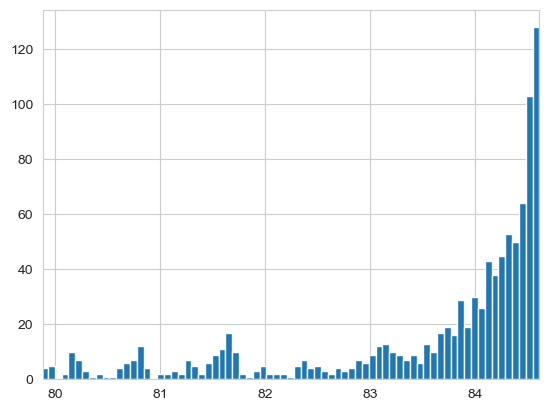

In [15]:
# Prints the distribution of Optimal Scores Obtained by the Algorithm
Scores = []
ParticleSolver = ParticleSwarm(Population_Size, Max_Iterations, Fit_Function, Search_Space, [0.0,5.0], False)
for index in range(1000):
    Best_Score, _ = ParticleSolver.Run_ParticleSwarm(omega = 1.0, c_1 = 1.0, c_2 = 1.0)
    Scores.append(Best_Score)
print(np.mean(Scores), np.std(Scores), np.quantile(Scores, 0.25), np.median(Scores), np.quantile(Scores, 0.75))
plt.hist(Scores, bins = 100)
plt.xlim([np.quantile(Scores,0.01),np.quantile(Scores,0.99)])